In [26]:
import pandas as pd
crash_2020 = pd.read_csv("E:/.AUPENN/MUSA 5500/data/CRASH_PHILADELPHIA_2020.csv")
crash_2021 = pd.read_csv("E:/.AUPENN/MUSA 5500/data/CRASH_PHILADELPHIA_2021.csv")
crash_2022 = pd.read_csv("E:/.AUPENN/MUSA 5500/data/CRASH_PHILADELPHIA_2022.csv")
crash_2023 = pd.read_csv("E:/.AUPENN/MUSA 5500/data/CRASH_PHILADELPHIA_2023.csv")
crash_2024 = pd.read_csv("E:/.AUPENN/MUSA 5500/data/CRASH_PHILADELPHIA_2024.csv")
crash_all = pd.concat([crash_2020, crash_2021, crash_2022, crash_2023, crash_2024], ignore_index=True)
crash_all

,CRN,ARRIVAL_TM,AUTOMOBILE_COUNT,BELTED_DEATH_COUNT,BELTED_SUSP_SERIOUS_INJ_COUNT,BICYCLE_COUNT,BICYCLE_DEATH_COUNT,BICYCLE_SUSP_SERIOUS_INJ_COUNT,BUS_COUNT,CHLDPAS_DEATH_COUNT,...,WORK_ZONE_LOC,WORK_ZONE_TYPE,WZ_CLOSE_DETOUR,WZ_FLAGGER,WZ_LAW_OFFCR_IND,WZ_LN_CLOSURE,WZ_MOVING,WZ_OTHER,WZ_SHLDER_MDN,WZ_WORKERS_INJ_KILLED
0,2020029257,1957.0,1,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020008631,942.0,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020006834,700.0,1,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020006451,825.0,2,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2020008695,1115.0,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45585,2025027435,510.0,1,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
45586,2025012535,NaN,1,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
45587,2025043500,2031.0,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
45588,2025007815,NaN,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


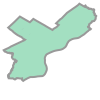

In [27]:
import geopandas as gpd
gdf = gpd.read_file("E:/.AUPENN/MUSA 5500/data/Planning_Districts.geojson")
gdf['dist_name'].unique()
philly = gdf.dissolve()
philly.geometry.values[0]

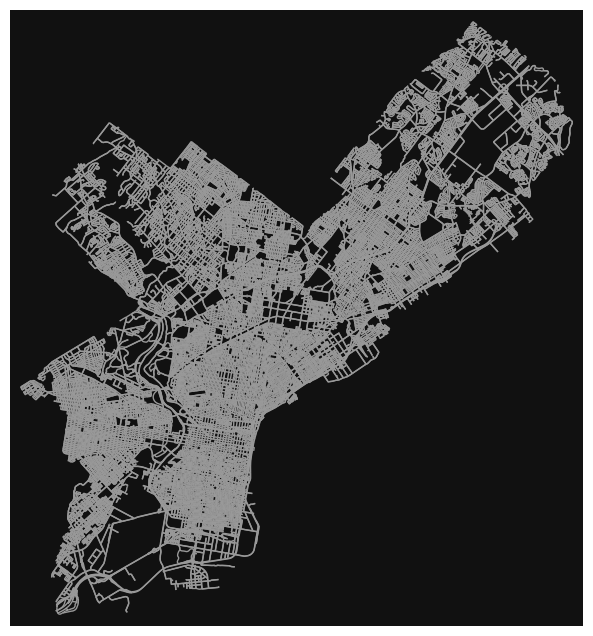

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [28]:
import osmnx as ox
philly_poly = philly.geometry.values[0]
G_cc = ox.graph_from_polygon(philly_poly, network_type='drive')
ox.plot_graph(ox.project_graph(G_cc), node_size=0)

In [29]:
type(G_cc)
# only get the edges
cc_edges = ox.graph_to_gdfs(G_cc, edges=True, nodes=False)
# we have lots of data associated with each edge!
cc_edges.head()

osmid  oneway               name      highway  \
u         v         key                                                      
109726936 109726940 0     12108955    True     Brunner Street  residential   
          109992543 0     43226669   False  Germantown Avenue      primary   
          109992535 0     43226669   False  Germantown Avenue      primary   
109726940 109726950 0    302956448   False       Wayne Avenue  residential   
          110047495 0    302956448   False       Wayne Avenue  residential   

                        reversed   length lanes maxspeed       service  \
u         v         key                                                  
109726936 109726940 0      False  174.382   NaN      NaN           NaN   
          109992543 0      False   55.074     2   25 mph  disused_tram   
          109992535 0       True    7.178     2   25 mph  disused_tram   
109726940 109726950 0      False   11.448   NaN      NaN           NaN   
          110047495 0       True   34.627   NaN      NaN           NaN   

                                                                  geometry  \
u         v         key                                                      
109726936 109726940 0    LINESTRING (-75.15542 40.01863, -75.15717 40.0...   
          109992543 0    LINESTRING (-75.15542 40.01863, -75.15569 40.0...   
          109992535 0    LINESTRING (-75.15542 40.01863, -75.15538 40.0...   
109726940 109726950 0    LINESTRING (-75.15717 40.01782, -75.15710 40.0...   
          110047495 0    LINESTRING (-75.15717 40.01782, -75.15738 40.0...   

                         ref bridge access tunnel width junction  
u         v         key                                           
109726936 109726940 0    NaN    NaN    NaN    NaN   NaN      NaN  
          109992543 0    NaN    NaN    NaN    NaN   NaN      NaN  
          109992535 0    NaN    NaN    NaN    NaN   NaN      NaN  
109726940 109726950 0    NaN    NaN    NaN    NaN   NaN      NaN  
          110047495 0    NaN    NaN    NaN    NaN   NaN      NaN

In [30]:
crash_all.columns
crash_all = crash_all.dropna(subset=["DEC_LATITUDE", "DEC_LONGITUDE"])
import geopandas as gpd
from shapely.geometry import Point
geometry = [Point(xy) for xy in zip(crash_all["DEC_LONGITUDE"], crash_all["DEC_LATITUDE"])]
crash_gdf = gpd.GeoDataFrame(crash_all, geometry=geometry, crs="EPSG:4326")
crash_gdf

,CRN,ARRIVAL_TM,AUTOMOBILE_COUNT,BELTED_DEATH_COUNT,BELTED_SUSP_SERIOUS_INJ_COUNT,BICYCLE_COUNT,BICYCLE_DEATH_COUNT,BICYCLE_SUSP_SERIOUS_INJ_COUNT,BUS_COUNT,CHLDPAS_DEATH_COUNT,...,WORK_ZONE_TYPE,WZ_CLOSE_DETOUR,WZ_FLAGGER,WZ_LAW_OFFCR_IND,WZ_LN_CLOSURE,WZ_MOVING,WZ_OTHER,WZ_SHLDER_MDN,WZ_WORKERS_INJ_KILLED,geometry
0,2020029257,1957.0,1,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-75.09453 39.99463)
1,2020008631,942.0,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-75.00614 40.04026)
2,2020006834,700.0,1,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-75.16127 40.02431)
3,2020006451,825.0,2,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-74.99057 40.11199)
4,2020008695,1115.0,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-75.20008 40.00740)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45585,2025027435,510.0,1,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-75.17294 39.92485)
45586,2025012535,NaN,1,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-75.11726 40.03163)
45587,2025043500,2031.0,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-75.15036 39.99339)
45588,2025007815,NaN,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-75.15567 40.02052)


In [31]:
philly_boundary = cc_edges.geometry.unary_union.convex_hull
crash_philly = crash_gdf[crash_gdf.within(philly_boundary)]
crash_philly.shape

(45331, 100)

In [32]:
G_cc_2272 = ox.project_graph(G_cc, to_crs="EPSG:2272")
crash_philly_2272 = crash_philly.to_crs(epsg=2272)
crash_x = crash_philly_2272.geometry.x.values
crash_y = crash_philly_2272.geometry.y.values
nearest_edges = ox.distance.nearest_edges(
    G_cc_2272,
    crash_x,
    crash_y
)
u_list = [edge[0] for edge in nearest_edges]
v_list = [edge[1] for edge in nearest_edges]
key_list = [edge[2] for edge in nearest_edges]
crash_philly_2272["u"] = u_list
crash_philly_2272["v"] = v_list
crash_philly_2272["key"] = key_list
crash_edges = crash_philly_2272[["u", "v"]]
crash_counts = crash_edges.groupby(["u", "v"]).size().reset_index(name="crash_count")

crash_counts.head()
crash_counts.shape

(15500, 3)

In [33]:
edges_df = cc_edges.reset_index()
edges_with_crashes = edges_df.merge(
    crash_counts,
    on=["u", "v"],
    how="left"
)
edges_with_crashes["crash_count"] = edges_with_crashes["crash_count"].fillna(0)
edges_with_crashes.head()

,u,v,key,osmid,oneway,name,highway,reversed,length,lanes,maxspeed,service,geometry,ref,bridge,access,tunnel,width,junction,crash_count
0,109726936,109726940,0,12108955,True,Brunner Street,residential,False,174.382,NaN,NaN,NaN,"LINESTRING (-75.15542 40.01863, -75.15717 40.0...",NaN,NaN,NaN,NaN,NaN,NaN,1.0
1,109726936,109992543,0,43226669,False,Germantown Avenue,primary,False,55.074,2,25 mph,disused_tram,"LINESTRING (-75.15542 40.01863, -75.15569 40.0...",NaN,NaN,NaN,NaN,NaN,NaN,4.0
2,109726936,109992535,0,43226669,False,Germantown Avenue,primary,True,7.178,2,25 mph,disused_tram,"LINESTRING (-75.15542 40.01863, -75.15538 40.0...",NaN,NaN,NaN,NaN,NaN,NaN,0.0
3,109726940,109726950,0,302956448,False,Wayne Avenue,residential,False,11.448,NaN,NaN,NaN,"LINESTRING (-75.15717 40.01782, -75.15710 40.0...",NaN,NaN,NaN,NaN,NaN,NaN,0.0
4,109726940,110047495,0,302956448,False,Wayne Avenue,residential,True,34.627,NaN,NaN,NaN,"LINESTRING (-75.15717 40.01782, -75.15738 40.0...",NaN,NaN,NaN,NaN,NaN,NaN,1.0


In [34]:
import numpy as np
edges_nonzero = edges_with_crashes[edges_with_crashes["crash_count"] > 0].copy()
edges_nonzero["crash_rate"] = edges_nonzero["crash_count"] / edges_nonzero["length"]

In [35]:
edges_nonzero["log_crash_rate"] = np.log10(edges_nonzero["crash_rate"])

In [36]:
min_val = edges_nonzero["log_crash_rate"].min()
max_val = edges_nonzero["log_crash_rate"].max()

edges_nonzero["crash_index"] = (edges_nonzero["log_crash_rate"] - min_val) / (max_val - min_val)

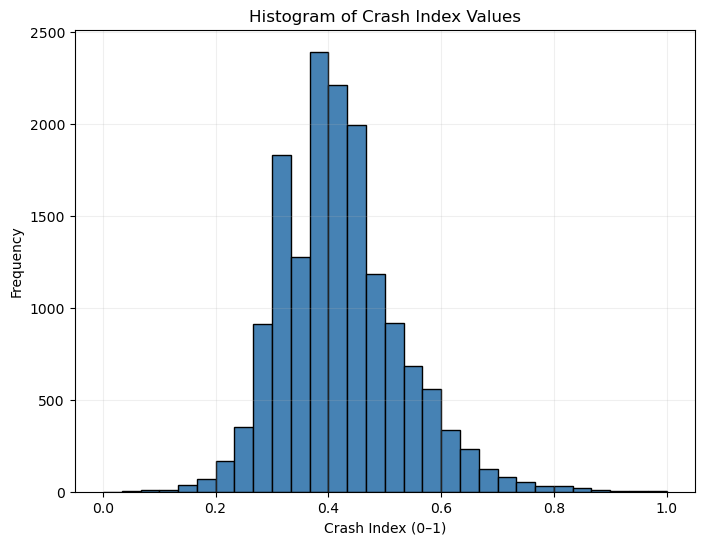

In [37]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.hist(edges_nonzero["crash_index"], bins=30, color="steelblue", edgecolor="black")
plt.title("Histogram of Crash Index Values")
plt.xlabel("Crash Index (0–1)")
plt.ylabel("Frequency")
plt.grid(alpha=0.2)

plt.show()

In [38]:
edges_nonzero.explore(
    column="crash_index",
    cmap="viridis",
    tiles="CartoDB dark_matter",
    tooltip=["u", "v", "crash_index"],
    style_kwds={"weight": 3}
)

In [42]:
import osmnx as ox
import geopandas as gpd
nodes, edges = ox.graph_to_gdfs(G_cc_2272, nodes=True, edges=True)

In [43]:
edges['length'].head()

u          v          key
109726936  109726940  0      174.382
           109992543  0       55.074
           109992535  0        7.178
109726940  109726950  0       11.448
           110047495  0       34.627
Name: length, dtype: float64

In [44]:
edges['highway_type'] = edges['highway'].apply(
    lambda x: x[0] if isinstance(x, list) else x
)

In [54]:
G_cc_2272 = ox.add_edge_speeds(G_cc_2272)
G_cc_2272 = ox.add_edge_travel_times(G_cc_2272)

nodes, edges = ox.graph_to_gdfs(
    G_cc_2272,
    nodes=True,
    edges=True,
    node_geometry=True,
    fill_edge_geometry=True
)

In [55]:
edges.columns

Index(['osmid', 'oneway', 'name', 'highway', 'reversed', 'length', 'speed_kph',
       'travel_time', 'lanes', 'maxspeed', 'service', 'geometry', 'bridge',
       'ref', 'access', 'tunnel', 'width', 'junction'],
      dtype='object')

In [48]:
import networkx as nx

degree_dict = dict(G_cc_2272.degree())
nx.set_node_attributes(G_cc_2272, degree_dict, "degree")

nodes['degree'] = nodes.index.map(degree_dict)

In [50]:
edges.columns

Index(['osmid', 'oneway', 'name', 'highway', 'reversed', 'length', 'speed_kph',
       'travel_time', 'lanes', 'maxspeed', 'service', 'geometry', 'bridge',
       'ref', 'access', 'tunnel', 'width', 'junction'],
      dtype='object')

In [60]:
import geopandas as gpd
from shapely.geometry import LineString

records = []

for u, v, key, data in G_cc_2272.edges(keys=True, data=True):
    row = data.copy()
    row['u'] = u
    row['v'] = v
    row['key'] = key

    # geometry: use node coordinates
    x1 = G_cc_2272.nodes[u]['x']
    y1 = G_cc_2272.nodes[u]['y']
    x2 = G_cc_2272.nodes[v]['x']
    y2 = G_cc_2272.nodes[v]['y']

    row['geometry'] = LineString([(x1, y1), (x2, y2)])

    records.append(row)

edges = gpd.GeoDataFrame(records, geometry='geometry', crs=2272)

In [61]:
edges.columns

Index(['osmid', 'oneway', 'name', 'highway', 'reversed', 'length', 'u', 'v',
       'key', 'geometry', 'lanes', 'maxspeed', 'service', 'ref', 'access',
       'bridge', 'width', 'tunnel', 'junction'],
      dtype='object')

In [62]:
import geopandas as gpd
from shapely.geometry import LineString

records = []

for u, v, key, data in G_cc_2272.edges(keys=True, data=True):
    
    row = {}

    # ---- 1. 复制所有属性（如果没有就给 None） ---- #
    for attr in [
        'osmid', 'oneway', 'name', 'highway', 'reversed',
        'length', 'speed_kph', 'travel_time', 'lanes',
        'maxspeed', 'service', 'bridge', 'ref', 'access',
        'tunnel', 'width', 'junction'
    ]:
        row[attr] = data.get(attr, None)

    # ---- 2. 添加 u / v / key ---- #
    row['u'] = u
    row['v'] = v
    row['key'] = key

    # ---- 3. 手动画 geometry（simplify=False 图没有 geometry） ---- #
    x1 = G_cc_2272.nodes[u]['x']
    y1 = G_cc_2272.nodes[u]['y']
    x2 = G_cc_2272.nodes[v]['x']
    y2 = G_cc_2272.nodes[v]['y']

    row['geometry'] = LineString([(x1, y1), (x2, y2)])

    records.append(row)

edges = gpd.GeoDataFrame(records, geometry='geometry', crs=2272)

In [63]:
edges.columns

Index(['osmid', 'oneway', 'name', 'highway', 'reversed', 'length', 'speed_kph',
       'travel_time', 'lanes', 'maxspeed', 'service', 'bridge', 'ref',
       'access', 'tunnel', 'width', 'junction', 'u', 'v', 'key', 'geometry'],
      dtype='object')

In [64]:
import networkx as nx

# degree dict
degree_dict = dict(G_cc_2272.degree())

nodes['degree'] = nodes.index.map(degree_dict)

edges['u_degree'] = edges['u'].map(degree_dict)
edges['v_degree'] = edges['v'].map(degree_dict)

edges['degree_mean'] = edges[['u_degree', 'v_degree']].mean(axis=1)

In [66]:
nodes_proj = nodes.to_crs(2272)

# buffer 300m
nodes_proj['buffer'] = nodes_proj.geometry.buffer(300)

# spatial join: number of nodes within 300m
buf = gpd.GeoDataFrame(nodes_proj[['buffer']], geometry='buffer', crs=2272)

join = gpd.sjoin(nodes_proj, buf, how='left')

local_close = join.groupby('index_right').size()

nodes['local_close'] = local_close

edges['u_close'] = edges['u'].map(local_close)
edges['v_close'] = edges['v'].map(local_close)

edges['closeness_mean'] = edges[['u_close','v_close']].mean(axis=1)

In [132]:
import geopandas as gpd

nodes_proj = nodes.to_crs(2272)

# intersection = degree >= 3
intersections = nodes_proj[nodes_proj['degree'] >= 3]

# buffer 300 m
intersections['buffer'] = intersections.geometry.buffer(100)

# spatial join
buf = gpd.GeoDataFrame(intersections[['buffer']], geometry='buffer', crs=2272)
join = gpd.sjoin(edges.to_crs(2272), buf, how='left')

# groupby join.index instead of index_left
edges['intersection_density'] = join.groupby(join.index).size()
edges['intersection_density'].fillna(0, inplace=True)

C:\ProgramData\anaconda3\envs\geospatial\lib\site-packages\geopandas\geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [89]:
import matplotlib.pyplot as plt
import geopandas as gpd

def plot_static(edges, column, title, cmap='viridis'):
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    
    edges.plot(
        ax=ax,
        column=column,
        cmap=cmap,
        linewidth=1,
        legend=True,
        legend_kwds={'label': title, 'orientation': 'horizontal'}
    )
    
    ax.set_title(title, fontsize=14)
    ax.set_axis_off()
    plt.show()

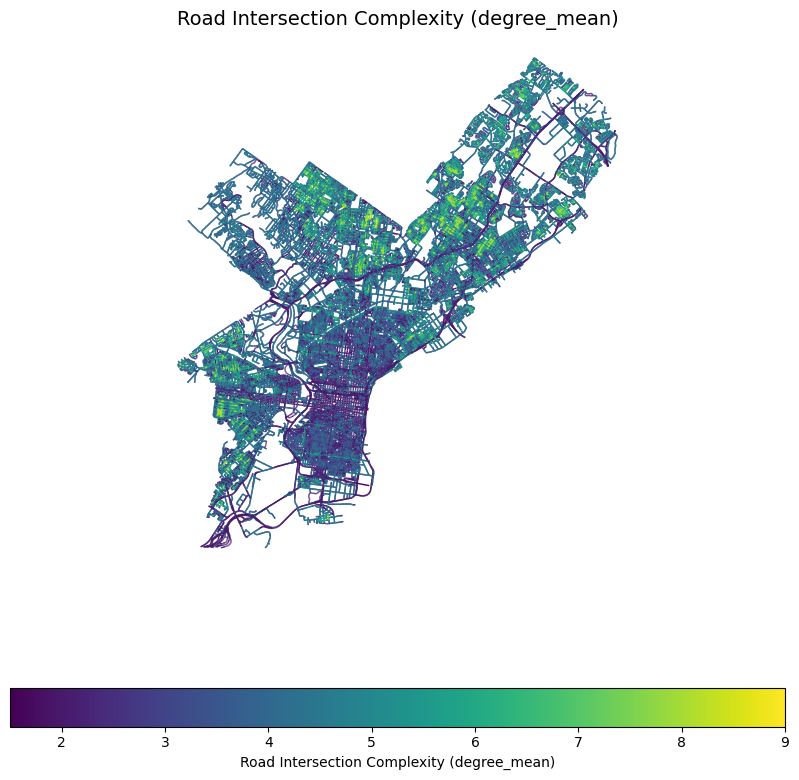

In [90]:
plot_static(
    edges,
    'degree_mean',
    'Road Intersection Complexity (degree_mean)',
    cmap='viridis'
)

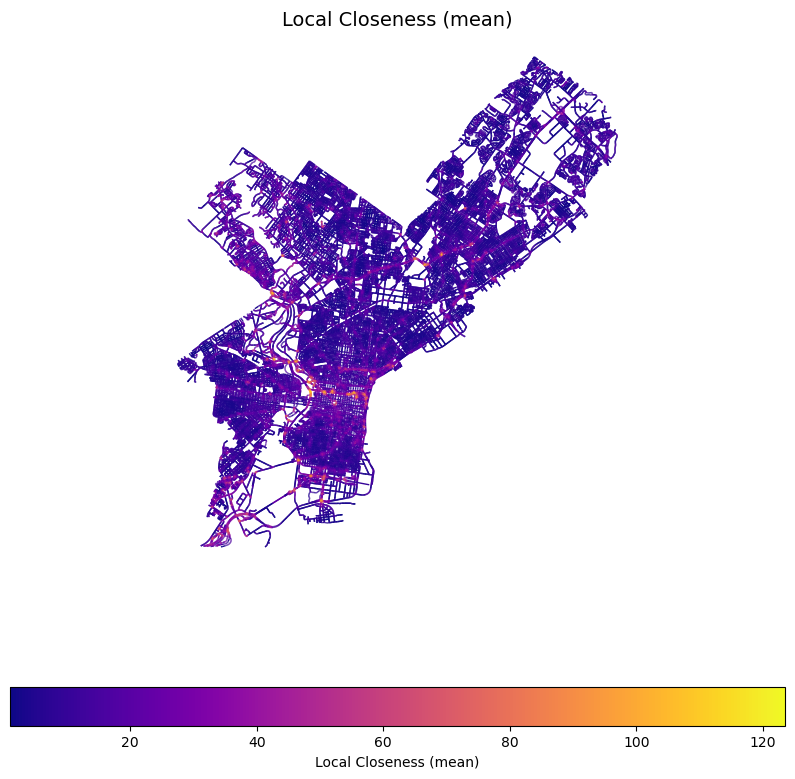

In [75]:
plot_static(
    edges,
    'closeness_mean',
    'Local Closeness (mean)',
    cmap='plasma'
)

gdf type: <class 'geopandas.geodataframe.GeoDataFrame'>


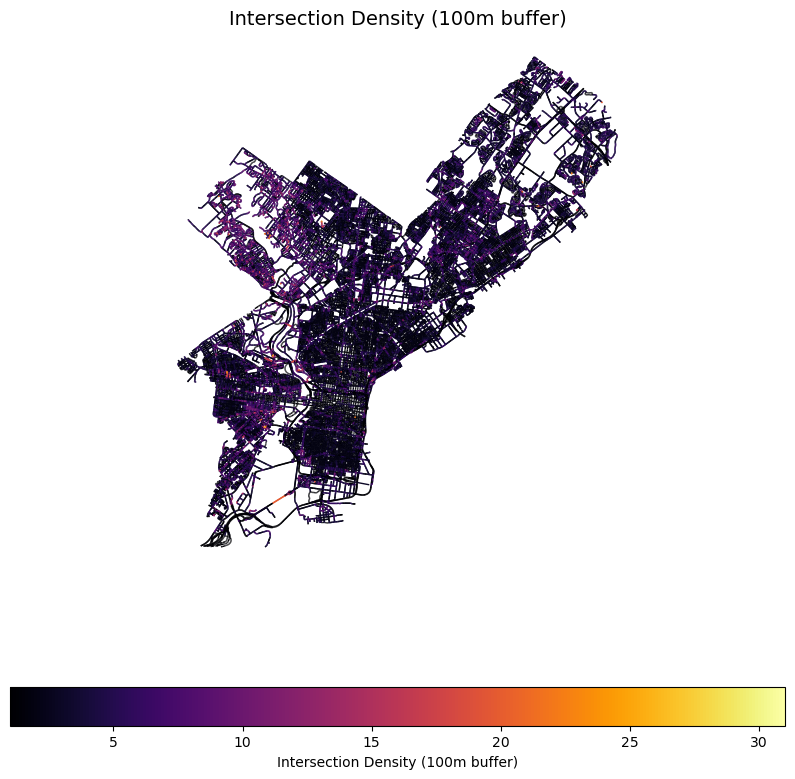

In [133]:
plot_static(
    edges,
    'intersection_density',
    'Intersection Density (100m buffer)',
    cmap='inferno'
)

In [102]:
G_cc = ox.add_edge_speeds(G_cc)
G_cc = ox.add_edge_travel_times(G_cc)

In [103]:
G_cc_2272_fix = ox.project_graph(G_cc, to_crs='EPSG:2272')

In [104]:
nodes_fix, edges_fix = ox.graph_to_gdfs(
    G_cc_2272_fix,
    nodes=True,
    edges=True,
    node_geometry=True,
    fill_edge_geometry=True
)

In [105]:
edges_fix = edges_fix.merge(
    edges[['u','v','key','degree_mean','closeness_mean','intersection_density']],
    on=['u','v','key'],
    how='left'
)

In [106]:
edges_fix

,u,v,key,osmid,oneway,name,highway,reversed,length,speed_kph,...,ref,access,bridge,width,tunnel,junction,geometry,degree_mean,closeness_mean,intersection_density
0,109726936,109726940,0,12108955,True,Brunner Street,residential,False,174.382,39.8,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2695094.165 260317.645, 2694612.05...",5.0,7.0,12
1,109726936,109992543,0,43226669,False,Germantown Avenue,primary,False,55.074,40.2,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2695094.165 260317.645, 2695012.93...",5.0,7.5,8
2,109726936,109992535,0,43226669,False,Germantown Avenue,primary,True,7.178,40.2,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2695094.165 260317.645, 2695105.14...",5.0,8.0,6
3,109726940,109726950,0,302956448,False,Wayne Avenue,residential,False,11.448,39.8,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2694612.057 260008.064, 2694632.29...",5.0,6.5,7
4,109726940,110047495,0,302956448,False,Wayne Avenue,residential,True,34.627,39.8,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2694612.057 260008.064, 2694550.85...",5.0,6.0,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205949,13337658572,13337658573,0,12112083,False,Awbury Road,residential,True,5.817,39.8,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2690961.710 271305.256, 2690966.50...",4.0,57.0,60
205950,13337658573,13337658572,0,12112083,False,Awbury Road,residential,False,5.817,39.8,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2690966.506 271286.810, 2690961.71...",4.0,57.0,60
205951,13337658573,13337658574,0,12112083,False,Awbury Road,residential,True,9.744,39.8,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2690966.506 271286.810, 2690975.05...",4.0,58.0,61
205952,13337658574,13337658573,0,12112083,False,Awbury Road,residential,False,9.744,39.8,...,NaN,NaN,NaN,NaN,NaN,NaN,"LINESTRING (2690975.051 271256.046, 2690966.50...",4.0,58.0,61


In [118]:
def plot_layer_categorical(gdf, column, title, cmap='tab20', linewidth=1):

    fig, ax = plt.subplots(1, 1, figsize=(10, 10))

    # 先绘制分类图
    gdf.plot(
        ax=ax,
        column=column,
        categorical=True,
        cmap=cmap,
        linewidth=linewidth,
        legend=False     # ← 先关闭默认 legend
    )
    
    ax.set_title(title, fontsize=16)
    ax.set_axis_off()

    # ------ 手动绘制 legend 并放在右下角 -------
    # 获取分类和颜色
    unique_vals = gdf[column].dropna().unique()
    unique_vals = sorted(unique_vals)

    # 获取 colormap
    import matplotlib as mpl
    cmap_obj = mpl.cm.get_cmap(cmap, len(unique_vals))

    # 创建自定义 legend handles
    handles = [
        mpl.patches.Patch(color=cmap_obj(i), label=str(val))
        for i, val in enumerate(unique_vals)
    ]

    # 添加 legend，定位到右下角
    ax.legend(
        handles=handles,
        title=title,
        loc='lower right',       # ← 放在右下角！
        frameon=True,
        fontsize=10,
        title_fontsize=12
    )

    plt.show()

C:\Users\UserX\AppData\Local\Temp\ipykernel_40812\580500310.py:25: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_obj = mpl.cm.get_cmap(cmap, len(unique_vals))


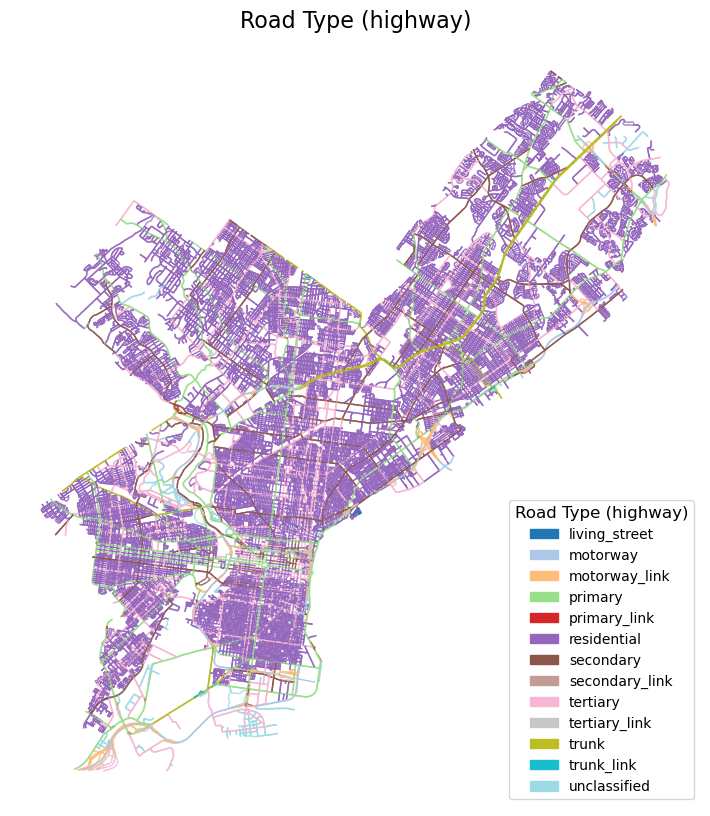

In [119]:
plot_layer_categorical(
    edges_fix,
    column='highway',
    title='Road Type (highway)',
    cmap='tab20'
)

In [120]:
def plot_layer_categorical(gdf, column, title, cmap='tab10', linewidth=1):
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))

    # 关闭默认 legend（我们自定义）
    gdf.plot(
        ax=ax,
        column=column,
        categorical=True,
        cmap=cmap,
        linewidth=linewidth,
        legend=False
    )

    ax.set_title(title, fontsize=16)
    ax.set_axis_off()

    # ---- 自定义 legend（右下角） ----
    unique_vals = sorted(gdf[column].dropna().unique())
    import matplotlib as mpl
    cmap_obj = mpl.cm.get_cmap(cmap, len(unique_vals))

    handles = [
        mpl.patches.Patch(color=cmap_obj(i), label=str(val))
        for i, val in enumerate(unique_vals)
    ]

    ax.legend(
        handles=handles,
        title=title,
        loc='lower right',
        frameon=True,
        fontsize=10,
        title_fontsize=12
    )

    plt.show()

C:\Users\UserX\AppData\Local\Temp\ipykernel_40812\357412056.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_obj = mpl.cm.get_cmap(cmap, len(unique_vals))


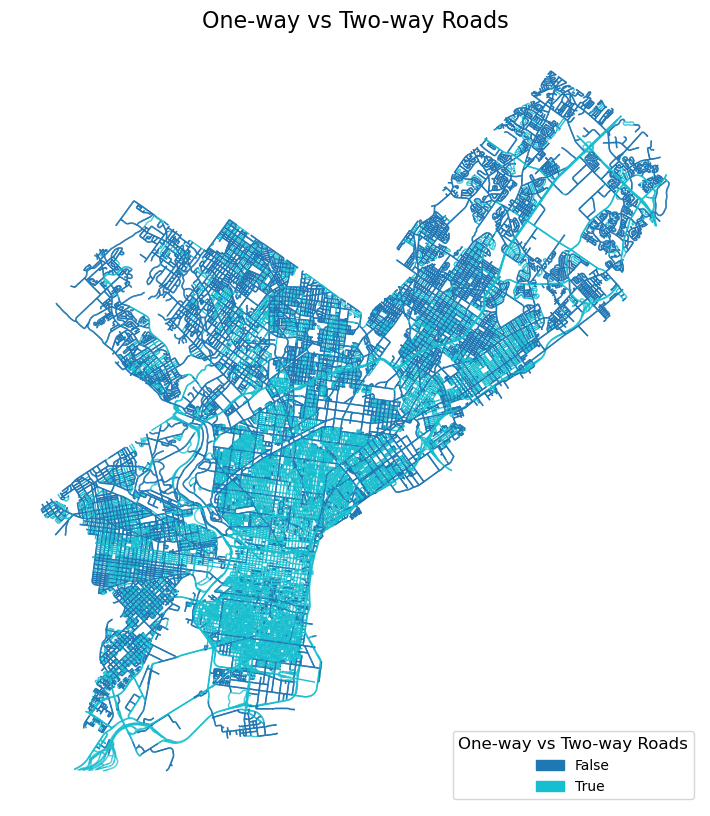

In [121]:
plot_layer_categorical(
    edges_fix,
    column='oneway',
    title='One-way vs Two-way Roads',
    cmap='tab10'
)

In [126]:
def plot_layer_continuous(gdf, column, title, cmap='viridis', linewidth=1):
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))

    gdf.plot(
        ax=ax,
        column=column,
        cmap=cmap,
        linewidth=linewidth,
        legend=True,
        legend_kwds={'label': title, 'orientation': 'horizontal'}
    )

    ax.set_title(title, fontsize=16)
    ax.set_axis_off()
    plt.show()

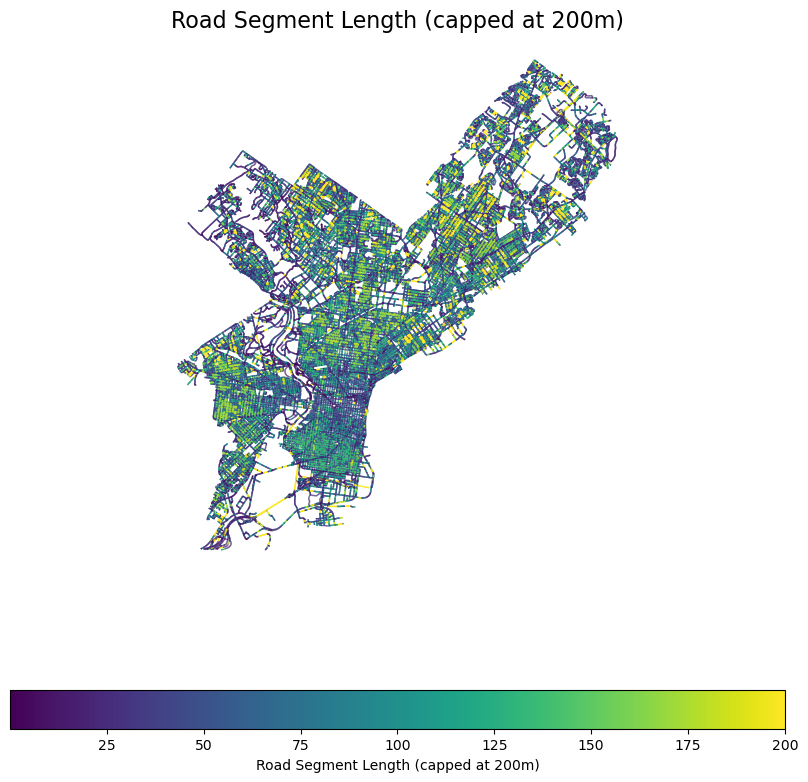

In [131]:
edges_fix['length_cap500'] = edges_fix['length'].clip(upper=200)
plot_layer_continuous(
    edges_fix,
    column='length_cap500',
    title='Road Segment Length (capped at 200m)',
    cmap='viridis'
)

In [129]:
edges_fix['length'].describe(percentiles=[0.5, 0.9, 0.95, 0.99])

count    205954.000000
mean         32.882444
std          39.974017
min           0.034000
50%          17.097000
90%          80.959100
95%         121.292500
99%         178.685580
max        1125.924000
Name: length, dtype: float64

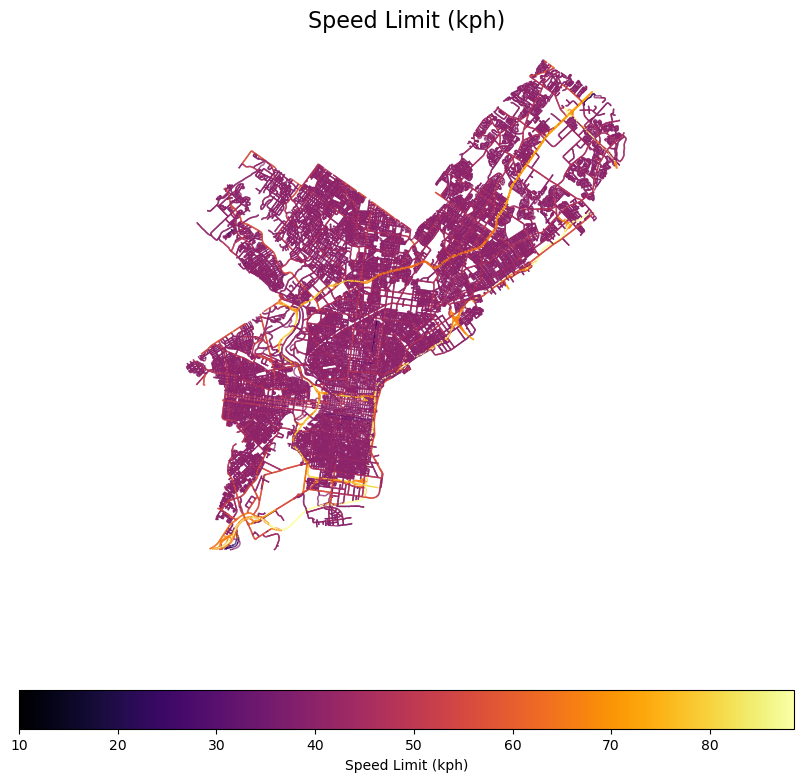

In [124]:
plot_layer_continuous(
    edges_fix,
    column='speed_kph',
    title='Speed Limit (kph)',
    cmap='inferno'
)

In [137]:
import seaborn as sns
import matplotlib.pyplot as plt

vars_to_check = ['degree_mean', 'closeness_mean',
                 'intersection_density', 'speed_kph', 'length']

for col in vars_to_check:
    plt.figure(figsize=(6,4))
    sns.regplot(data=edges_nonzero, x=col, y='crash_index',
                scatter_kws={'s':5, 'alpha':0.3},
                line_kws={'color':'red'})
    plt.title(f'{col} vs crash_index')
    plt.show()

KeyError: 'degree_mean'

<Figure size 600x400 with 0 Axes>

In [138]:
edges_nonzero

,u,v,key,osmid,oneway,name,highway,reversed,length,lanes,...,ref,bridge,access,tunnel,width,junction,crash_count,crash_rate,log_crash_rate,crash_index
0,109726936,109726940,0,12108955,True,Brunner Street,residential,False,174.382,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.005735,-2.241502,0.298801
1,109726936,109992543,0,43226669,False,Germantown Avenue,primary,False,55.074,2,...,NaN,NaN,NaN,NaN,NaN,NaN,4.0,0.072630,-1.138887,0.577686
4,109726940,110047495,0,302956448,False,Wayne Avenue,residential,True,34.627,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.028879,-1.539415,0.476380
8,109726961,110211923,0,43226676,False,Clarissa Street,secondary,True,51.828,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,4.0,0.077178,-1.112504,0.584359
11,109726983,110294253,0,1423600168,False,Wissahickon Avenue,tertiary,False,105.380,2,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.009489,-2.022758,0.354128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61627,12985201876,110243425,0,"[423956628, 384988511]",True,Grant Avenue,secondary,False,230.835,2,...,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.008664,-2.062272,0.344134
61628,12985201877,109909278,0,"[12122913, 1351740566]",False,Northeast Avenue,residential,False,109.733,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.009113,-2.040337,0.349682
61646,13161762988,110251604,0,1424710200,False,Elmwood Avenue,tertiary,True,128.435,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.007786,-2.108683,0.332395
61649,13161762992,768663617,0,61654940,True,Passyunk Avenue,residential,False,195.411,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.005117,-2.290949,0.286294


In [140]:
merged = edges_nonzero.merge(
    edges_fix[['u', 'v', 'key', 'degree_mean', 'closeness_mean',
               'intersection_density', 'speed_kph', 'length']],
    on=['u', 'v', 'key'],
    how='left'
)
merged

,u,v,key,osmid,oneway,name,highway,reversed,length_x,lanes,...,junction,crash_count,crash_rate,log_crash_rate,crash_index,degree_mean,closeness_mean,intersection_density,speed_kph,length_y
0,109726936,109726940,0,12108955,True,Brunner Street,residential,False,174.382,NaN,...,NaN,1.0,0.005735,-2.241502,0.298801,5.0,7.0,12.0,39.8,174.382
1,109726936,109992543,0,43226669,False,Germantown Avenue,primary,False,55.074,2,...,NaN,4.0,0.072630,-1.138887,0.577686,5.0,7.5,8.0,40.2,55.074
2,109726940,110047495,0,302956448,False,Wayne Avenue,residential,True,34.627,NaN,...,NaN,1.0,0.028879,-1.539415,0.476380,5.0,6.0,7.0,39.8,34.627
3,109726961,110211923,0,43226676,False,Clarissa Street,secondary,True,51.828,NaN,...,NaN,4.0,0.077178,-1.112504,0.584359,5.0,6.5,9.0,45.5,51.828
4,109726983,110294253,0,1423600168,False,Wissahickon Avenue,tertiary,False,105.380,2,...,NaN,1.0,0.009489,-2.022758,0.354128,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15535,12985201876,110243425,0,"[423956628, 384988511]",True,Grant Avenue,secondary,False,230.835,2,...,NaN,2.0,0.008664,-2.062272,0.344134,NaN,NaN,NaN,NaN,NaN
15536,12985201877,109909278,0,"[12122913, 1351740566]",False,Northeast Avenue,residential,False,109.733,NaN,...,NaN,1.0,0.009113,-2.040337,0.349682,NaN,NaN,NaN,NaN,NaN
15537,13161762988,110251604,0,1424710200,False,Elmwood Avenue,tertiary,True,128.435,NaN,...,NaN,1.0,0.007786,-2.108683,0.332395,NaN,NaN,NaN,NaN,NaN
15538,13161762992,768663617,0,61654940,True,Passyunk Avenue,residential,False,195.411,NaN,...,NaN,1.0,0.005117,-2.290949,0.286294,NaN,NaN,NaN,NaN,NaN


In [144]:
df = merged.copy()
# 必须保留非零 crash_index
df = df[df['crash_index'] > 0].copy()

# 删除关键字段缺失
df = df.dropna(subset=['degree_mean','closeness_mean','intersection_density','speed_kph','length_x'])

# length 去极端值
q99 = df['length_x'].quantile(0.99)
df = df[df['length_x'] <= q99]

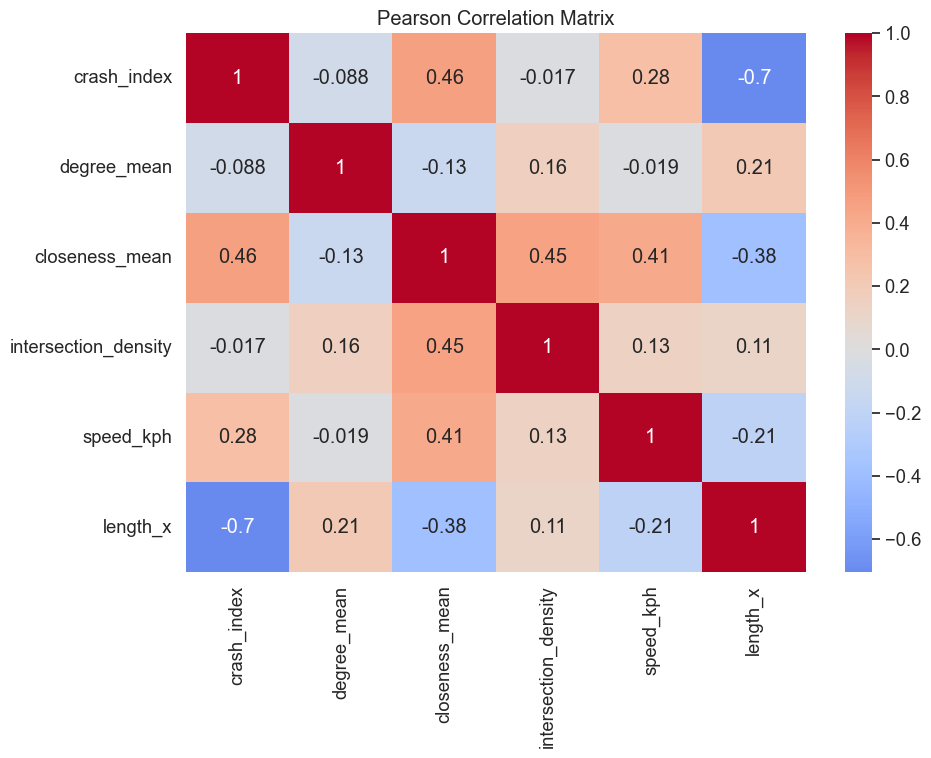

In [145]:
import seaborn as sns
import matplotlib.pyplot as plt

num_cols = ['crash_index','degree_mean','closeness_mean','intersection_density',
            'speed_kph','length_x']

plt.figure(figsize=(10,7))
sns.heatmap(df[num_cols].corr(), annot=True, cmap='coolwarm', center=0)
plt.title("Pearson Correlation Matrix")
plt.show()

In [146]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd

X = df[['degree_mean','closeness_mean','intersection_density','speed_kph','length_x']]
vif_df = pd.DataFrame()
vif_df['variable'] = X.columns
vif_df['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif_df

,variable,VIF
0,degree_mean,16.514291
1,closeness_mean,4.099467
2,intersection_density,7.303775
3,speed_kph,19.642160
4,length_x,4.662089


In [149]:
import statsmodels.api as sm

# 选择变量（推荐：intersection_density 模型）
X = df[['closeness_mean', 'intersection_density', 'length_x']]
y = df['crash_index']

# 添加常数项
X = sm.add_constant(X)

# OLS 回归
model = sm.OLS(y, X).fit()

# 输出结果
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:            crash_index   R-squared:                       0.542
Model:                            OLS   Adj. R-squared:                  0.542
Method:                 Least Squares   F-statistic:                     1663.
Date:                Wed, 03 Dec 2025   Prob (F-statistic):               0.00
Time:                        23:29:23   Log-Likelihood:                 5025.0
No. Observations:                4220   AIC:                        -1.004e+04
Df Residuals:                    4216   BIC:                        -1.002e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.5355 

In [150]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.inspection import PartialDependenceDisplay
import matplotlib.pyplot as plt
import numpy as np

# 选择变量
features = ['closeness_mean', 'intersection_density', 'length_x']
X = df[features]
y = df['crash_index']

# 随机森林模型
rf = RandomForestRegressor(
    n_estimators=300,
    random_state=42,
    max_depth=12,
    min_samples_leaf=20
)
rf.fit(X, y)

RandomForestRegressor(max_depth=12, min_samples_leaf=20, n_estimators=300,
                      random_state=42)

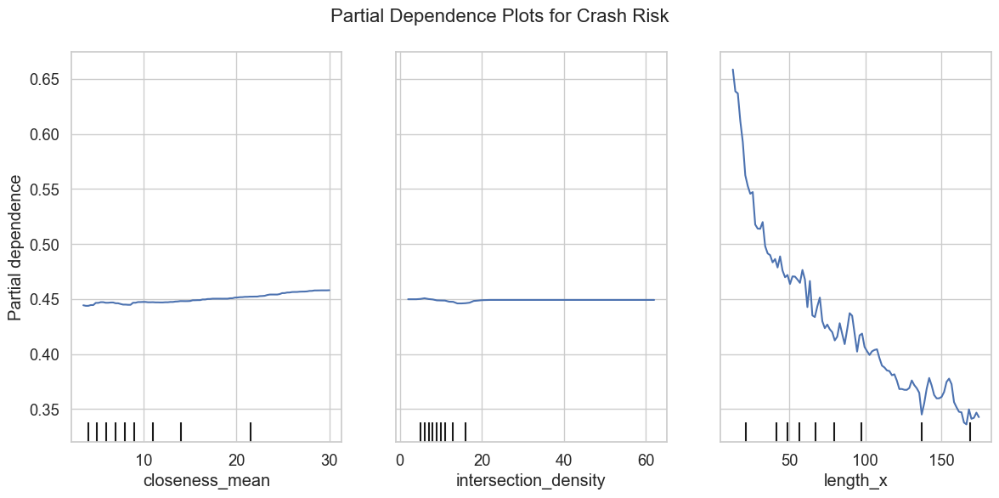

In [151]:
fig, ax = plt.subplots(figsize=(12, 6))
PartialDependenceDisplay.from_estimator(
    rf, X, features,
    kind="average",
    ax=ax
)
plt.suptitle("Partial Dependence Plots for Crash Risk", fontsize=16)
plt.tight_layout()
plt.show()

In [152]:
pip install shap

  Obtaining dependency information for shap from https://files.pythonhosted.org/packages/af/e1/3d52717b617b9ad1e4d0c9634d3b7c52a913540fde27c4b4663a7ee76b87/shap-0.49.1-cp310-cp310-win_amd64.whl.metadata
  Obtaining dependency information for slicer==0.0.8 from https://files.pythonhosted.org/packages/63/81/9ef641ff4e12cbcca30e54e72fb0951a2ba195d0cda0ba4100e532d929db/slicer-0.0.8-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/547.0 kB ? eta -:--:--
   -- ------------------------------------ 41.0/547.0 kB 991.0 kB/s eta 0:00:01
   -- ------------------------------------ 41.0/547.0 kB 991.0 kB/s eta 0:00:01
   ------ -------------------------------- 92.2/547.0 kB 751.6 kB/s eta 0:00:01
   ------ -------------------------------- 92.2/547.0 kB 751.6 kB/s eta 0:00:01
   ---------- --------------------------- 153.6/547.0 kB 654.6 kB/s eta 0:00:01
   ------------ ------------------------- 174.1/547.0 kB 700.2 kB/s eta 0:00:01
   ------------ ------------------------- 

In [153]:
import shap

explainer = shap.TreeExplainer(rf)
shap_values = explainer.shap_values(X)

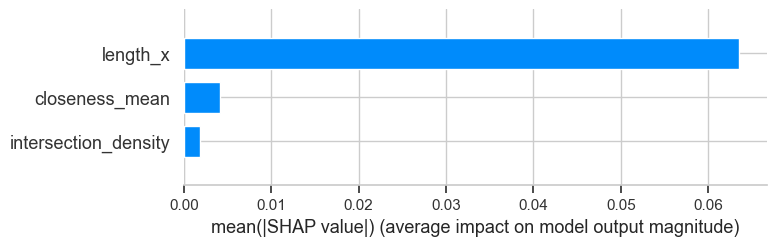

In [154]:
shap.summary_plot(shap_values, X, plot_type="bar")

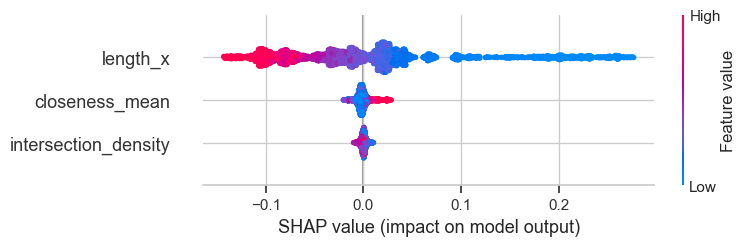

In [155]:
shap.summary_plot(shap_values, X)

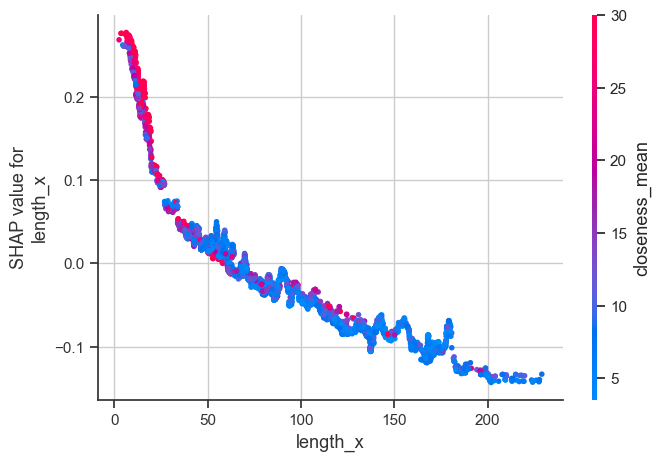

In [156]:
shap.dependence_plot('length_x', shap_values, X)